# Assignment 2: Depth Estimation From Stereo and Video
## Deadline: November 11 (Friday), 2022 at 5pm
## **LIU CHAOWEI A0263758N**

 Read carefully: Academic integrity must be strictly followed. Copying-and-pasting from other's code or from any sources is not allowed. Software will be used to detect any forms of source code plagiarism. The maximum score for completing part 1 until part 4 is 85. More scores are given for submission on part 5. You must indicate the parts and numbers clearly. Your submitted code must be grouped/separated into the same parts as in the instructions. In your submission, you must provide us with all necessary libraries. If you use separate files in your submission, you must zip them to one file. The submission must not be in separate files in different times (it must be submitted together). The deadline is a strict deadline, so please prepare and plan early and carefully. Late submission will be deducted 2 points (out of 10) for every 24 hours.

Programming language: Python version 3. Submission: Jupyter Notebook (any other format won't be accepted). In your Jupyter notebook file, you must compile the codes and show the results there in the file. If you have multiple files in your submission, you must zip them into one file.

## Part 1: Noise Removal

### 1.2 Write a python program to clean up the noise of the image in Figure 1, by employing an MRF and the binary graphcuts. See the pseudocode in C here.

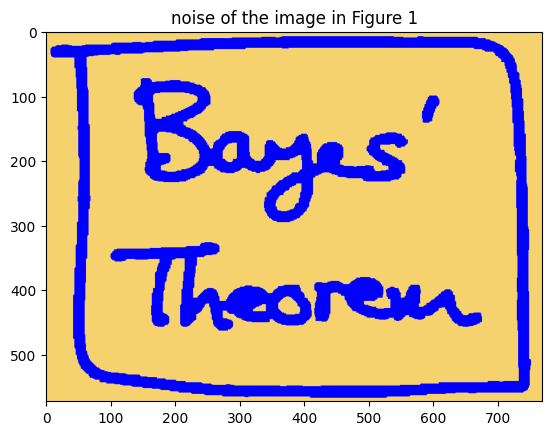

In [1]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import gco

def dist(c1,c2):
    return (abs(c1[0] - c2[0]) + abs(c1[1] - c2[1]) + abs(c1[2] - c2[2])) / 3

img = cv.imread('data/bayes_in.jpg')
img = img[:,:,[2,1,0]]

H, W, D = img.shape
SOURCE_COLOR = [0, 0, 255]
#  blue = foreground
SINK_COLOR = [245, 210, 110]
# yellow = background
smooth = 1-np.eye(2)
unary = np.zeros((H, W, 2))
maxunary = 0
for i in range(H):
    for j in range(W):
        unary[i,j,0] = dist(img[i,j,:],SOURCE_COLOR)
        unary[i,j,1] = dist(img[i,j,:],SINK_COLOR)
        maxunary = max(unary[i,j,0],maxunary)
        maxunary = max(unary[i,j,1],maxunary)
unary = unary / maxunary
labels = gco.cut_grid_graph_simple(unary, smooth, n_iter=-1)
labels = labels.reshape(H, W)
image_out = np.zeros((img.shape))
for i in range(H):
    for j in range(W):
        if labels[i,j] == 1: image_out[i,j,:]=SINK_COLOR
        if labels[i,j] == 0: image_out[i,j,:]=SOURCE_COLOR
image_out = np.array(image_out, dtype='uint8')
plt.imshow(image_out)
plt.title('noise of the image in Figure 1')
plt.show()


### 1.3 Change the value of the weighting factor (lambda) of the prior term, and show some different results (due to different values of lambda). You must state the values of your lambda along with the corresponding results.

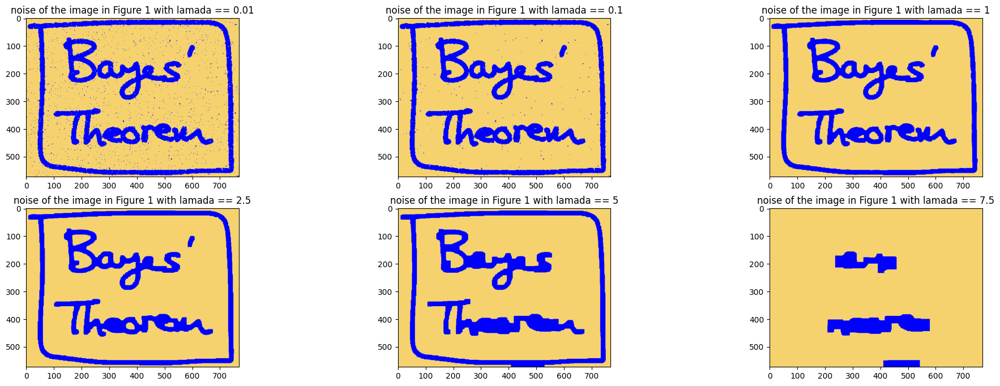

In [2]:
lambda_list = [0.01,0.1,1,2.5,5,7.5]
fig, axarr = plt.subplots(ncols=3,nrows=2, figsize=(24,8))
for k in range(len(lambda_list)):
    labels = gco.cut_grid_graph_simple(unary, smooth*lambda_list[k], n_iter=-1)
    labels = labels.reshape(H, W)
    image_out = np.zeros((img.shape))
    for i in range(H):
        for j in range(W):
            if labels[i,j] == 1: image_out[i,j,:]=SINK_COLOR
            if labels[i,j] == 0: image_out[i,j,:]=SOURCE_COLOR
    image_out = np.array(image_out, dtype='uint8')
    axarr[k//3,k%3].set_title(f'noise of the image in Figure 1 with lamada == {lambda_list[k]}')
    axarr[k//3,k%3].imshow(image_out)
    

### 1.4 Disscussion: the bigger the lambda is, the better the denoising performance is. It can be seen when lambda equal to 1, it will show the best result.

## Part 2: Depth from Rectified Stereo Images
### 2.1 Write a program to estimate a depth map from the pair of rectified images in Figure 2 using an MRF and multiple label graphcuts.

In [5]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import gco
def dist(c1,c2):
    return (abs(int(c1[0]) - int(c2[0])) + abs(int(c1[1]) - int(c2[1]))+ abs(int(c1[2]) - int(c2[2])))/10

img1 = cv.imread('data/im6.png')
img1 = img1[:,:,[2,1,0]]
img2 = cv.imread('data/im2.png')
img2 = img2[:,:,[2,1,0]]
H,W,D = img1.shape
print(H,W)
d_number = 65
disparity = np.arange(d_number)

smooth = np.zeros((d_number,d_number))
for i in range(d_number):
    for j in range(d_number):
        if i!= j:
            smooth[i][j] = abs(i-j)

unary = np.zeros((H, W, d_number))
maxunary = 0

for i in range(H):
    for j in range(W):
        for k in range(d_number):
            if j+k<W:
                unary[i,j,k] = dist(img1[i,j,:],img2[i,j+k,:])
                maxunary = max(unary[i,j,k],maxunary)

# unary = unary/maxunary

print('fine to compute unary')

375 450
fine to compute unary


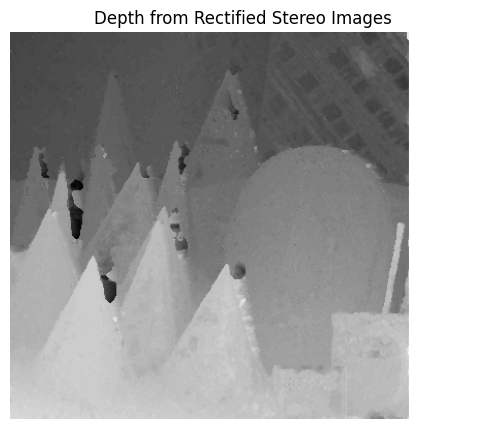

In [6]:
labels = gco.cut_grid_graph_simple(unary,smooth*0.1,connect = 8, n_iter=-1)
labels = labels.reshape(H, W)
plt.figure(num=1, dpi=100, figsize=(6,6))
plt.imshow(labels,cmap='gray')
plt.title('Depth from Rectified Stereo Images')
plt.imshow(labels,cmap="gray")
plt.axis("off")
plt.show()

### 2.2 Disscussion for part2
There are some noise in the depth result.

This because that there are just simple and less constraint for pv and pc in graph cut, which means we can not get the best result.

## Part 3: Depth from Stereo:
### 3.1 Write a program to estimate a depth map from a pair of calibrated images in Figure 4 using an MRF and graphcuts. The camera matrices are available here. Note that, for finding the epipolar lines using the provided camera matrices, you might want to use the following equation:

In [7]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import gco
K1 = np.array([[1221.2270770,0.0000000,479.5000000],[0.0000000,1221.2270770,269.5000000],[0.0000000,0.0000000,1.0000000]])
R1 = np.array([[1.0000000000,0.0000000000,0.0000000000],[0.0000000000,1.0000000000,0.0000000000],[0.0000000000,0.0000000000,1.0000000000]])
T1 = np.array([[0.0000000000],[0.0000000000],[0.0000000000]])

K2 = np.array([[1221.2270770,0.0000000,479.5000000],[0.0000000,1221.2270770,269.5000000],[0.0000000,0.0000000,1.0000000]])
R2 = np.array([[0.9998813487,0.0148994942,0.0039106989],[-0.0148907594,0.9998865876,-0.0022532664],[-0.0039438279,0.0021947658,0.9999898146]])
T2 = np.array([[-9.9909793759],[0.2451742154],[0.1650832670]])

disparity = np.arange(0,0.01,0.01/65)

d_number = len(disparity)

img1 = cv.imread('data/test00.jpg')
img1 = img1[:,:,[2,1,0]]
img2 = cv.imread('data/test09.jpg')
img2 = img2[:,:,[2,1,0]]
H,W,D = img1.shape
print(img1.shape)
term2 = np.dot(np.dot(np.dot(K2,R2.T),R1),np.linalg.inv(K1))

term1 = np.dot(np.dot(K2,R2.T),(T1-T2))
print(term2)
print(term1)
x_h_x = np.tile(np.arange(W)[:,np.newaxis],[1,H]).T.reshape(1,-1)
x_h_y = np.tile(np.arange(H)[:,np.newaxis],[1,W]).reshape(1,-1)


x_h = np.concatenate((x_h_x,x_h_y,np.ones(H*W).reshape(1,-1)),axis=0)
x_h_int = x_h.astype(int)
print(x_h.shape)
x_h_term = np.dot(term2,x_h)
print(x_h_term.shape)
x_h_1 = np.tile(x_h[:, :, np.newaxis], [1, 1, d_number])
for i in range(d_number):
    d_add = disparity[i]*term1
    # d_add_tile = np.tile(d_add[:,:],[1,H*W])
    x_h_1[:,:,i] = x_h_term + d_add

print(x_h_1.shape)
print(x_h_int)


(540, 960, 3)
[[ 1.00141684e+00 -1.57754771e-02 -1.24907567e+00]
 [ 1.57625060e-02  9.99389337e-01 -4.71598561e+00]
 [ 3.20227006e-06 -1.84508389e-06  9.98951576e-01]]
[[ 1.21449036e+04]
 [-1.51840163e+02]
 [-1.25457431e-01]]
(3, 518400)
(3, 518400)
(3, 518400, 65)
[[  0   1   2 ... 957 958 959]
 [  0   0   0 ... 539 539 539]
 [  1   1   1 ...   1   1   1]]


In [8]:
def dist(c1,c2):
    return (abs(int(c1[0]) - int(c2[0])) + abs(int(c1[1]) - int(c2[1]))+ abs(int(c1[2]) - int(c2[2])))/20

d_number = len(disparity)
smooth = np.zeros((d_number,d_number))
# smooth = 1-np.eye(d_number)
for i in range(d_number):
    for j in range(d_number):
        if i!= j:
            smooth[i][j] = abs(i-j)
unary = np.zeros((H, W, d_number))
maxunary = 0

for i in range(H):
    for j in range(W):
        x,y = x_h_int[0:2,i*W+j]
        for k in range(d_number):
            x_1,y_1,z_1=x_h_1[:,i*W+j,k]
            x_1 = int(x_1/z_1)
            y_1 = int(y_1/z_1)
            if 0<=x_1<W and 0<=y_1<H:
                unary[y,x,k] = dist(img1[y,x,:],img2[y_1,x_1,:])
                maxunary = max(unary[y,x,k],maxunary)
                
# unary = unary/maxunary

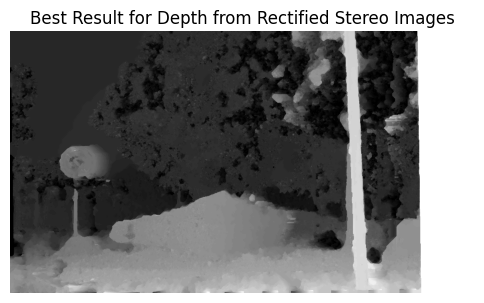

In [9]:
labels = gco.cut_grid_graph_simple(unary,smooth*0.1, connect=8,n_iter=-1)
labels = labels.reshape(H, W)
plt.figure(num=1, dpi=100, figsize=(6,6))
plt.imshow(labels,cmap='gray')
plt.title('Best Result for Depth from Rectified Stereo Images')
plt.axis("off")
plt.show()

### 3.3 Disscussion for part3:
There are some noise in the depth result.
And it also seem not so smooth.
There may be two resons:
- we have not choose for the best parameters for the method and
- the method which we use now have less and simple constraint in pc and pv when we use the graph cut algorithm.

## Part 4: Depth from Video -- Basic:
### 4.1 Write a program to estimate depth map from video using the method described in this paper: Depth Map from Video Sequence.

In [10]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import gco
import os

def homogeneous_coord_grid(h,w):
    
    X, Y = np.float32(np.meshgrid(
                np.arange(w, dtype=np.float32),
                np.arange(h, dtype=np.float32),
                indexing='xy'))
    
    X, Y, Z = (np.expand_dims(X,axis=0), 
               np.expand_dims(Y,axis=0), 
               np.ones([1, h, w], np.float32))
    
    return np.concatenate([X, Y, Z], axis=0)
    
def get_coordinates(K, R1, T1, R2, T2 , coorsxy, d,h,w):
  
    coorsxy = np.reshape(coorsxy, [3,-1])
    d = np.reshape(d, [1, -1])

    depth = (T1-T2).T * d 
    remap = (K*R2.T) * ((R1*K.I) * coorsxy + depth)
    remap = np.divide(remap, remap[2, :])
    remap = np.reshape(np.asarray(remap), [3, h, w])
    return remap

def L2(img_a, img_b):
    return np.sqrt(np.sum(np.square(img_a-img_b), axis=-1, keepdims=True))

def L2_f(img_a, img_b):
    return np.sqrt(np.sum(np.square(img_a-img_b), axis=-1, keepdims=False))
    
def read_directory(directory_name):
    array_of_img = []
    for filename in os.listdir(r"./"+directory_name):
        img = cv.imread(directory_name + "/" + filename)
        array_of_img.append(np.float32(img))
    return array_of_img

def distance(x_h,projected_x_prime_h):
    return np.sum(np.square(x_h - projected_x_prime_h), axis=0,keepdims=False)

def load_depthmaps(directory,sequence):
    D = []
    for i in range(len(sequence)):
        depthmap_name = os.path.join(directory, "depth_"+str(i).zfill(4)+".npy")
        
        depthmap = np.load(depthmap_name)
        D.append(depthmap)
    return D

def load_params(filename):
    with open(filename,'r') as f:
        frame_num = int(f.readline())
        f.readline()
        
        def read_vector():
            vec = f.readline().split()
            return np.array([float(x) for x in vec], dtype=np.float32)
            
        def read_matrix():
            r1 = read_vector()
            r2 = read_vector()
            r3 = read_vector()
            return np.matrix([r1,r2,r3], dtype=np.float32)
        
        K_sequence = [None]*frame_num
        R_sequence = [None]*frame_num
        T_sequence = [None]*frame_num
        
        for i in range(frame_num):
            K_sequence[i] = read_matrix()
            R_sequence[i] = read_matrix()
            T_sequence[i] = np.asmatrix(read_vector())
            f.readline()
            f.readline()
    return K_sequence, R_sequence, T_sequence

def remap(I_t_prime,x_prime):
    return cv.remap(
                src=I_t_prime, 
                map1=x_prime, 
                map2=None, 
                interpolation=cv.INTER_NEAREST, 
                borderValue=[128, 128, 128])

def get_smooth_simple(d_number,threshold):
    smooth = np.zeros((d_number,d_number))
    for i in range(d_number):
        for j in range(d_number):
            if i!= j:
                smooth[i][j] = min(abs(i-j),threshold)
    return smooth
    
def get_depth_map(unary,smooth,lambda_factor=0.06):
    labels = gco.cut_grid_graph_simple(unary,smooth*lambda_factor, connect=4,n_iter=-1)
    labels = labels.reshape(H, W)
    return labels

def get_depth_map_HW(unary,smooth,H, W,lambda_factor=0.06):
    labels = gco.cut_grid_graph_simple(unary,smooth*lambda_factor, connect=4,n_iter=-1)
    labels = labels.reshape(H, W)
    return labels

### 4.2 Disparity Initialization

Disparity Initialization choose_fram ==100 sequence =[101 102 103 104 105 106 107 108]
Disparity Initialization for image 101
get_depth_map................................


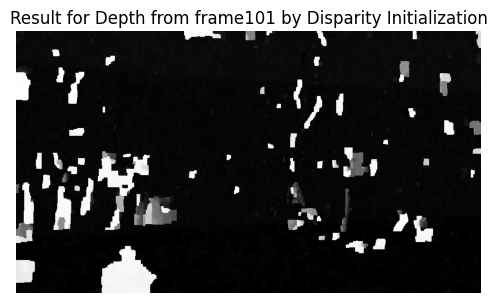

Disparity Initialization for image 102
get_depth_map................................


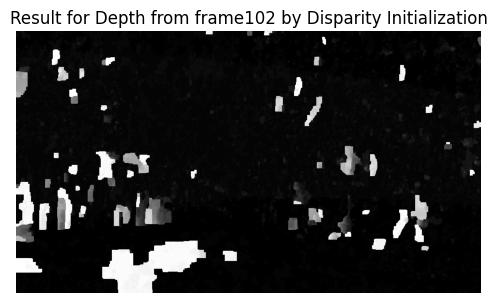

Disparity Initialization for image 103
get_depth_map................................


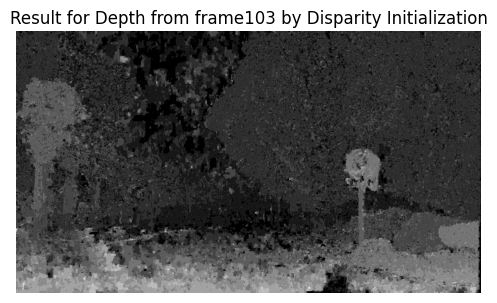

Disparity Initialization for image 104
get_depth_map................................


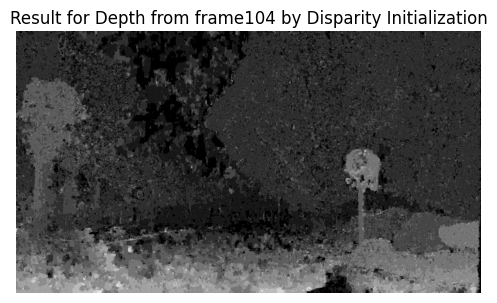

Disparity Initialization for image 105
get_depth_map................................


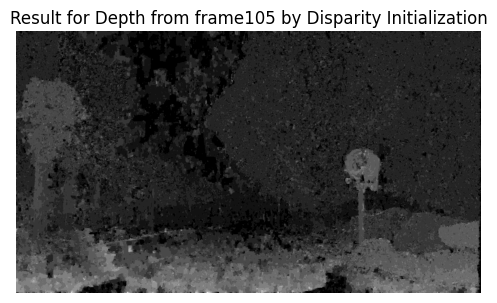

Disparity Initialization for image 106
get_depth_map................................


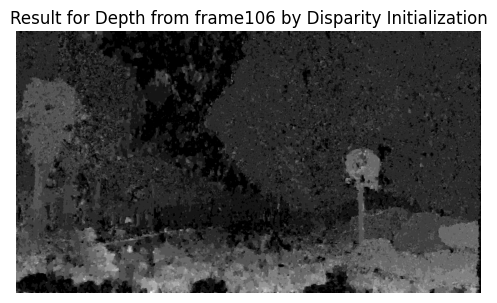

Disparity Initialization for image 107
get_depth_map................................


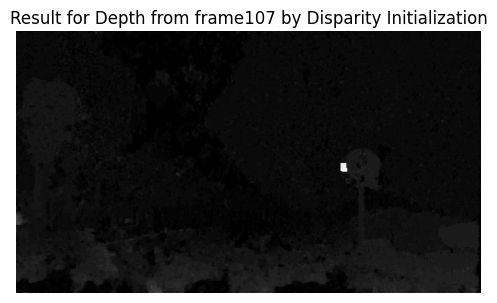

Disparity Initialization for image 108
get_depth_map................................


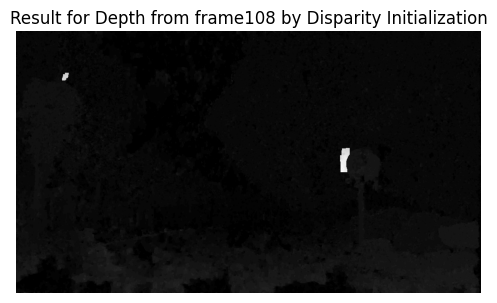

In [12]:

files = 'data/Road/src'
txt_path ='data/Road/cameras.txt'
out_dir = 'data/Road/depth'

K,R,T = load_params(txt_path)
array_of_img = read_directory(files)

H,W,D = array_of_img[0].shape
disparity = np.arange(0,0.02,0.02/65)
d_numbers = len(disparity)

choose_frame = 100

sequence = np.array([101,102,103,104,105,106,107,108])

num_frame = sequence.shape[0]
L = np.zeros((H, W, d_numbers))

print(f'Disparity Initialization choose_fram =={choose_frame} sequence ={sequence}')
use_bundle = False
depth_map_save = []
img1 = array_of_img[choose_frame]

h, w = H,W
I_t = img1
sigma_c=1.0
sigma_d=2.5

x_h = homogeneous_coord_grid(H,W) #[3, h, w]
d = np.zeros([H, W], dtype=np.float32) #[h, w]
L = np.zeros([d_numbers, H, W], dtype=np.float32) #[d_numbers, h, w]
D = np.zeros([num_frame,H, W])
for i in range(num_frame):
    print(f'Disparity Initialization for image {sequence[i]}')
    I_t_prime = array_of_img[sequence[i]]
    fram = sequence[i]
    for d_number in range(d_numbers):

        d[:,:] = disparity[d_number] 

        x_prime_h = get_coordinates(K[choose_frame], R[choose_frame], T[choose_frame], R[fram], T[fram] ,x_h, d,h,w)

        x_prime = np.transpose(x_prime_h[:2,:,:], [1,2,0])
        I_t_projected = remap(I_t_prime,x_prime)

        color_distance = L2(I_t, I_t_projected)
        pc = sigma_c/(sigma_c + color_distance)
        if not use_bundle:
            L[d_number,:,:] += pc[:,:,0]

    u = np.reciprocal(L.max(axis=0, keepdims=True))    
    unary= 1 - u*L
    final_unary=np.zeros((H,W,d_number))
    for k in range(d_number):
        final_unary[:,:,k] = unary[k,:,:]

    smooth = get_smooth_simple(d_number,threshold=10)

    depthmap = get_depth_map(final_unary,smooth,lambda_factor=0.1)
    D[i,:,:] = depthmap
    print('get_depth_map................................')
    plt.figure(num=1, dpi=100, figsize=(6,6))
    plt.imshow(depthmap,cmap='gray')
    plt.title(f'Result for Depth from frame{sequence[i]} by Disparity Initialization')
    plt.axis("off")
    plt.show()
    # save for every frame of deptj:
    
    # depthmap_filename = os.path.join(out_dir, "depth_"+str(i).zfill(4))
         
    # np.save(depthmap_filename, depthmap)

    # Max = np.float32(depthmap.max())
    # cv.imwrite(depthmap_filename+'.png', np.uint8(depthmap/Max*255))


### 4.2 bundle optimization steps.

Boundle Optimization: choose_fram ==100 sequence =[101 102 103 104 105 106 107 108]
solving img101
solving img102
solving img103
solving img104
solving img105
solving img106
solving img107
solving img108
get_depth_map................................


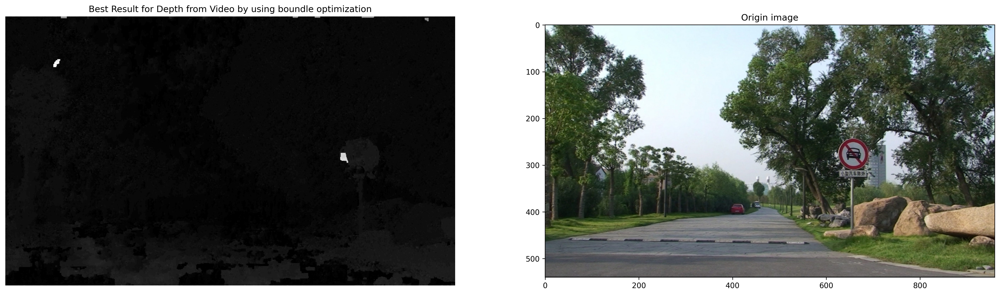

In [14]:
print(f'Boundle Optimization: choose_fram =={choose_frame} sequence ={sequence}')
for i in range(num_frame):
    I_t_prime = array_of_img[sequence[i]]
    print(f"solving img{sequence[i]}")
    for d_number in range(d_numbers):

        d[:,:] = disparity[d_number] 

        x_prime_h = get_coordinates(K[choose_frame], R[choose_frame], T[choose_frame], R[fram], T[fram] ,x_h, d,h,w)

        x_prime = np.transpose(x_prime_h[:2,:,:], [1,2,0])
        I_t_projected = remap(I_t_prime,x_prime)
        color_difference = L2_f(I_t, I_t_projected)
        pc = sigma_c/(sigma_c + color_difference)
        
        # D = load_depthmaps(out_dir,sequence)
        depth_indices = np.array(D[i]).astype(np.int64)
        # depth_indices = 
        depth_indices_projected = cv.remap(
                src=depth_indices,
                map1=x_prime,
                map2=None,
                interpolation=cv.INTER_NEAREST,
                borderValue=int(d_numbers / 2.0))
        
        np.take(disparity, depth_indices_projected, out=d)
        
        projected_x_prime_h = get_coordinates(K[fram], R[fram], T[fram], R[choose_frame], T[choose_frame] ,x_prime_h, d,h,w)
        color_distance = distance(x_h,projected_x_prime_h)


        pv = np.exp(color_distance/(-2*sigma_d*sigma_d))
        
        L[d_number,:,:] += pc*pv

u = np.reciprocal(L.max(axis=0, keepdims=True))
unary= 1 - u*L
final_unary=np.zeros((H,W,d_number))
for i in range(d_number):
    final_unary[:,:,i] = unary[i,:,:]

smooth = get_smooth_simple(d_number,threshold=10)

print('get_depth_map................................')
depthmap = get_depth_map(final_unary,smooth,lambda_factor=0.06)
plt.figure(dpi=300,figsize=(24,8))
plt.subplot(121)
plt.imshow(depthmap[:,0:900],cmap='gray')
plt.title('Best Result for Depth from Video by using boundle optimization')
plt.axis("off")
plt.subplot(122)
plt.title('Origin image')
img = cv.imread(files + "/" + 'test0100.jpg')
img = img[:,:,[2,1,0]]
plt.imshow(img)
plt.show()


### 4.6 discussion:
The best result we have shown in the above  in sec 4.2 boundl optimization.

Here we use the **9 frames** to get the best result.

It can be seen that the result is pretty good but still have some noise which I would slove it in Part5.

## Part 5: Depth from Video -- Advanced:
### Job:
Find the drawbacks of the paper, and implement your solutions. For this, you must explain the drawbacks, show evidence of the drawbacks, discuss how your solutions can solve the drawback, and show the improved results (in comparison to the original results).  
### Drawbacks:
After implementing the paper 'Depth Map from Video Sequence', the image also has some noise, which we can not solve although we change the parameters in the paper.  
The noise of the image can be seen in the figure 'origin depth map for frame 100', noise is particularly noticeable in the sky.  
We also show the background of the depth map of fame 100, where the yellow pixels mean the front and the blue pixels mean the background.
Compared with the original image, it can be seen that there is a lot of noise in the sky where should be blue (which means the background, is really far away)  
### Solutions:
After evaluating the depth for different frames, it can be seen that the noise is random (which could be seen in **Sec 1**), and generally speaking, for each pixel, the probability of noise is relatively small, so if we have enough depth evaluation machine for one pixel, We can use voting mechanism (like boosting) to decide whether it is in the background(far away).  
#### Implementation process
- choose n frame to make depth evaluation(by using the paper method) -------------> get n depth map  
- using the RANSAC to get n-1 homography matrix for (n-1) frames with the choose frame -------------> get n-1 homography matrix  
- make homography transform for the depth map to the chosen frame space ------------->get n depth map after transforming  
- make voting to decide whether the pixel is in the background -------------> get a voting result
- process the original depth map for the chosen frame by using voting result -------------> get improved result
### Improved Result:
It can be seen that the noise in the sky is removed.

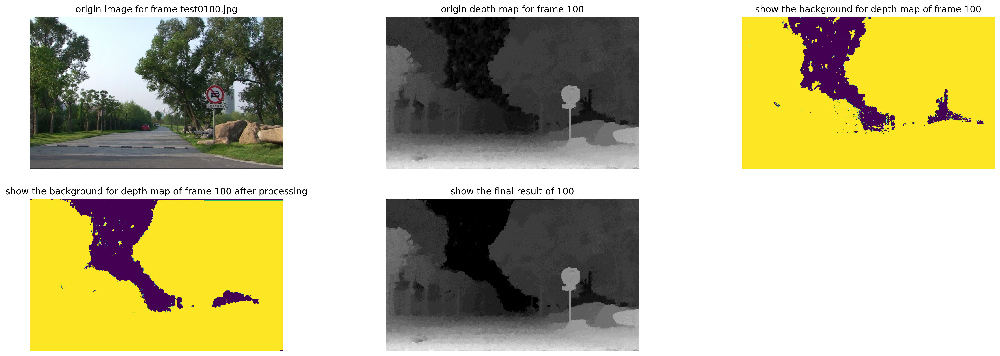

In [106]:
# # need to run Sec 0 - Sec 5, after that run this patch
# img = cv.imread(files + "/" + f'test0100.jpg')
# img = img[:,:,[2,1,0]]
# xx = np.where(depthmap_seq[5]>2,1,0)
# plt.figure(dpi=300,figsize=(24,8))
# plt.subplot(231)
# plt.imshow(img[:,0:900])
# plt.title(f'origin image for frame test0100.jpg')
# plt.axis("off")
# plt.subplot(232)
# plt.imshow(np.array(depthmap_seq[5][:,0:900]),cmap='gray')
# plt.axis("off")
# plt.title(f'origin depth map for frame {choose_frame_sequence[0]}')
# plt.subplot(233)
# plt.title(f'show the background for depth map of frame {choose_frame_sequence[0]}')
# plt.imshow(xx[:,0:900])
# plt.axis("off")
# plt.subplot(234)
# plt.title(f'show the background for depth map of frame {choose_frame_sequence[0]} after processing')
# plt.imshow(xxfinal[:,0:900]) 
# plt.axis("off")
# plt.subplot(235)
# plt.title(f'show the final result of {choose_frame_sequence[0]}')
# plt.imshow(depth_final[:,0:900],cmap='gray') 
# plt.axis("off")
# plt.show()

#### **Sec 0** some function which will be used in part 5

In [16]:
from re import A
import cv2
import numpy as np
import matplotlib.pyplot as plt
from numpy import linalg as la
from  PIL  import Image
from tkinter import NONE
files = 'data/Road/src'
np.set_printoptions(suppress=True)

def drawMatches(img1, kp1, des1, img2, kp2,des2):
    matcher = cv2.BFMatcher()
    raw_matches = matcher.knnMatch(des1, des2, k=2)
    good_points = []
    good_matches=[]
    for m1, m2 in raw_matches:
        if m1.distance < ratio * m2.distance:
            good_points.append((m1.trainIdx, m1.queryIdx))
            good_matches.append([m1])
    imgout = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_matches, None, flags=2)
    return imgout

ratio=0.85
min_match=10
sift=cv2.SIFT_create()
smoothing_window_size=800

import random
from numpy import linalg as la

def run_ransac(threshold,image1_kp, image2_kp, is_inlier, sample_size, goal_inliers, max_iterations, stop_at_goal=True):
    max_ic = 0
    best_matrix = None

    for i in range(max_iterations):
        index = np.random.choice(np.arange(image1_kp.shape[0]), size=sample_size, replace=False)
        image1_kp_sample = image1_kp[index,:]
        image2_kp_sample = image2_kp[index,:]
        homography_matrix = creat_homography(image1_kp_sample,image2_kp_sample,sample_size)
        ic,ik = 0,0
        for j in range(len(image1_kp_sample)):
            if is_inlier(compute_homography(image1_kp_sample[j],homography_matrix),image2_kp_sample[j],threshold):
                ik += 1
        if ik == sample_size-1:
            for j in range(len(image1_kp)):
                if is_inlier(compute_homography(image1_kp[j,:],homography_matrix), image2_kp[j,:],threshold):
                    ic += 1
        if ic > max_ic:
            max_ic = ic
            best_matrix = homography_matrix
            if max_ic > goal_inliers and stop_at_goal:
                print(max_ic,goal_inliers,stop_at_goal)
                break

    return best_matrix

def is_inlier(m,n,threshold):
    if pow(pow(m[0]-n[0],2)+pow(m[1]-n[1],2),0.5) < threshold:
        return True
    else: return False

def creat_homography(image1_kp_sample,image2_kp_sample,sample_size=5): 
    A_matrix=np.zeros((2*sample_size,9))
    x1,y1,x2,y2 = image1_kp_sample[:,0],image1_kp_sample[:,1],image2_kp_sample[:,0],image2_kp_sample[:,1]
    for i in range(sample_size):
        A_matrix[2*i:2*i+2,:] = [[x1[i],y1[i],1,0,0,0,-x2[i]*x1[i],-x2[i]*y1[i],-x2[i]],[0,0,0,x1[i],y1[i],1,-y2[i]*x1[i],-y2[i]*y1[i],-y2[i]]]
    U,sigma,VT = la.svd(np.mat(A_matrix))
    homography_matrix=(VT[-1,:].reshape(3,3))
    return homography_matrix

def compute_homography(data,homography_matrix):
    x = data[0]
    y = data[1]
    after_x = (homography_matrix[0,0]*x+homography_matrix[0,1]*y+homography_matrix[0,2])/(homography_matrix[2,0]*x+homography_matrix[2,1]*y+homography_matrix[2,2])
    after_y = (homography_matrix[1,0]*x+homography_matrix[1,1]*y+homography_matrix[1,2])/(homography_matrix[2,0]*x+homography_matrix[2,1]*y+homography_matrix[2,2])
    return np.float32([after_x,after_y])

def findgood_points(img1, kp1, des1, img2, kp2,des2):
    matcher = cv2.BFMatcher()
    raw_matches = matcher.knnMatch(des1, des2, k=2)
    good_points = []
    good_matches=[]
    for m1, m2 in raw_matches:
        if m1.distance < ratio * m2.distance:
            good_points.append((m1.trainIdx, m1.queryIdx))
            good_matches.append([m1])
    return good_points


def stitch_image(fram1, fram2,depthmap,pltshow):
    print(f"compute homogrphy matrix for {fram1} and {fram2}")
    img0102 = cv2.imread(files + "/" + f'{fram1}.jpg')
    img3 = cv2.imread(files + "/" + f'{fram2}.jpg')
    img0102 = img0102[:,:,[2,1,0]]
    img3 = img3[:,:,[2,1,0]]

    kp3, des3 = sift.detectAndCompute(img3, None)
    kp0102, des0102 = sift.detectAndCompute(img0102, None)

    good_points = findgood_points(img0102,kp0102,des0102,img3,kp3,des3)

    image0102_kp = np.float32([kp0102[i].pt for (_, i) in good_points])
    image3_kp = np.float32([kp3[i].pt for (i, _) in good_points])
    cols,rows,ch=img0102.shape
    # needtosum = np.float32([rows,cols]*len(image0102_kp)).reshape(-1,2)
    # image0102_kp = image0102_kp +needtosum
    image0102_kp = image0102_kp
    sample_size =5
    max_iterations =100000
    goal_inliers = 60
    threshold = 5
    H3_12 = run_ransac(threshold,image3_kp, image0102_kp, is_inlier, sample_size, goal_inliers, max_iterations, stop_at_goal=False)
    return H3_12


In [17]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import gco
import os

def homogeneous_coord_grid(h,w):
    
    X, Y = np.float32(np.meshgrid(
                np.arange(w, dtype=np.float32),
                np.arange(h, dtype=np.float32),
                indexing='xy'))
    
    X, Y, Z = (np.expand_dims(X,axis=0), 
               np.expand_dims(Y,axis=0), 
               np.ones([1, h, w], np.float32))
    
    return np.concatenate([X, Y, Z], axis=0)
    
def get_coordinates(K, R1, T1, R2, T2 , coorsxy, d,h,w):
  
    coorsxy = np.reshape(coorsxy, [3,-1])
    d = np.reshape(d, [1, -1])

    depth = (T1-T2).T * d 
    remap = (K*R2.T) * ((R1*K.I) * coorsxy + depth)
    remap = np.divide(remap, remap[2, :])
    remap = np.reshape(np.asarray(remap), [3, h, w])
    return remap

def L2(img_a, img_b):
    return np.sqrt(np.sum(np.square(img_a-img_b), axis=-1, keepdims=True))

def L2_f(img_a, img_b):
    return np.sqrt(np.sum(np.square(img_a-img_b), axis=-1, keepdims=False))
    
def read_directory(directory_name):
    array_of_img = []
    for filename in os.listdir(r"./"+directory_name):
        img = cv.imread(directory_name + "/" + filename)
        array_of_img.append(np.float32(img))
    return array_of_img

def distance(x_h,projected_x_prime_h):
    return np.sum(np.square(x_h - projected_x_prime_h), axis=0,keepdims=False)

def load_depthmaps(directory,sequence):
    D = []
    for i in range(len(sequence)):
        depthmap_name = os.path.join(directory, "depth_"+str(i).zfill(4)+".npy")
        
        depthmap = np.load(depthmap_name)
        D.append(depthmap)
    return D

def load_params(filename):
    with open(filename,'r') as f:
        frame_num = int(f.readline())
        f.readline()
        
        def read_vector():
            vec = f.readline().split()
            return np.array([float(x) for x in vec], dtype=np.float32)
            
        def read_matrix():
            r1 = read_vector()
            r2 = read_vector()
            r3 = read_vector()
            return np.matrix([r1,r2,r3], dtype=np.float32)
        
        K_sequence = [None]*frame_num
        R_sequence = [None]*frame_num
        T_sequence = [None]*frame_num
        
        for i in range(frame_num):
            K_sequence[i] = read_matrix()
            R_sequence[i] = read_matrix()
            T_sequence[i] = np.asmatrix(read_vector())
            f.readline()
            f.readline()
    return K_sequence, R_sequence, T_sequence

def remap(I_t_prime,x_prime):
    return cv.remap(
                src=I_t_prime, 
                map1=x_prime, 
                map2=None, 
                interpolation=cv.INTER_NEAREST, 
                borderValue=[128, 128, 128])


def get_smooth_simple(d_number,threshold):
    smooth = np.zeros((d_number,d_number))
    for i in range(d_number):
        for j in range(d_number):
            if i!= j:
                smooth[i][j] = min(abs(i-j),threshold)
    return smooth
    
def get_depth_map(unary,smooth,lambda_factor=0.06):
    labels = gco.cut_grid_graph_simple(unary,smooth*lambda_factor, connect=4,n_iter=-1)
    labels = labels.reshape(H, W)
    return labels

def get_depth_map_HW(unary,smooth,lambda_factor=0.06):
    labels = gco.cut_grid_graph_simple(unary,smooth*lambda_factor, connect=4,n_iter=-1)
    return labels

In [18]:
def get_depth_forframe(choose_frame):
    files = 'data/Road/src'
    txt_path = 'data/Road/cameras.txt'
    out_dir = 'data/Road/depth'

    K,R,T = load_params(txt_path)
    array_of_img = read_directory(files)

    H,W,D = array_of_img[0].shape
    disparity = np.arange(0,0.02,0.02/65)
    d_numbers = len(disparity)

    sequence = np.arange(choose_frame+1,choose_frame+8)

    num_frame = sequence.shape[0]
    L = np.zeros((H, W, d_numbers))

    print(f'Disparity Initialization choose_fram =={choose_frame} sequence ={sequence}')
    use_bundle = False
    depth_map_save = []
    img1 = array_of_img[choose_frame]

    h, w = H,W
    I_t = img1
    sigma_c=1.0
    sigma_d=2.5

    x_h = homogeneous_coord_grid(H,W) #[3, h, w]
    d = np.zeros([H, W], dtype=np.float32) #[h, w]
    L = np.zeros([d_numbers, H, W], dtype=np.float32) #[d_numbers, h, w]
    D = np.zeros([num_frame,H, W])
    for i in range(num_frame):
        I_t_prime = array_of_img[sequence[i]]
        fram = sequence[i]
        for d_number in range(d_numbers):

            d[:,:] = disparity[d_number] 

            x_prime_h = get_coordinates(K[choose_frame], R[choose_frame], T[choose_frame], R[fram], T[fram] ,x_h, d,h,w)

            x_prime = np.transpose(x_prime_h[:2,:,:], [1,2,0])
            I_t_projected = remap(I_t_prime,x_prime)

            color_distance = L2_f(I_t, I_t_projected)
            pc = sigma_c/(sigma_c + color_distance)
            if not use_bundle:
                L[d_number,:,:] += pc

        u = np.reciprocal(L.max(axis=0, keepdims=True))    
        unary= 1 - u*L
        final_unary=np.zeros((H,W,d_number))
        for k in range(d_number):
            final_unary[:,:,k] = unary[k,:,:]

        smooth = get_smooth_simple(d_number,threshold=10)
        
        depthmap = get_depth_map_HW(final_unary,smooth,lambda_factor=0.1)

        depthmap = depthmap.reshape(H,W)

        D[i,:,:] = depthmap

    print(f'Boundle Optimization: choose_fram =={choose_frame} sequence ={sequence}')
    for i in range(num_frame):
        I_t_prime = array_of_img[sequence[i]]
        for d_number in range(d_numbers):

            d[:,:] = disparity[d_number] 

            x_prime_h = get_coordinates(K[choose_frame], R[choose_frame], T[choose_frame], R[fram], T[fram] ,x_h, d,h,w)

            x_prime = np.transpose(x_prime_h[:2,:,:], [1,2,0])
            I_t_projected = remap(I_t_prime,x_prime)
            color_difference = L2_f(I_t, I_t_projected)
            pc = sigma_c/(sigma_c + color_difference)
            

            depth_indices = np.array(D[i,:,:]).astype(np.int64)

            depth_indices_projected = cv.remap(
                src=depth_indices,
                map1=x_prime,
                map2=None,
                interpolation=cv.INTER_NEAREST,
                borderValue=int(d_number / 2.0))         
            np.take(disparity, depth_indices_projected, out=d)
            
            projected_x_prime_h = get_coordinates(K[fram], R[fram], T[fram], R[choose_frame], T[choose_frame] ,x_prime_h, d,h,w)
            color_distance = distance(x_h,projected_x_prime_h)


            pv = np.exp(color_distance/(-2*sigma_d*sigma_d))
            
            L[d_number,:,:] += pc*pv

    u = np.reciprocal(L.max(axis=0, keepdims=True))
    unary= 1 - u*L
    final_unary=np.zeros((H,W,d_number))
    for i in range(d_number):
        final_unary[:,:,i] = unary[i,:,:]

    smooth = get_smooth_simple(d_number,threshold=10)

    print('get_depth_map................................')
    depthmap = get_depth_map_HW(final_unary,smooth,lambda_factor=0.1)

    depthmap = depthmap.reshape(H,W)
    plt.figure(dpi=300,figsize=(24,8))
    plt.subplot(121)
    plt.imshow(depthmap,cmap='gray')
    plt.title('Best Result for Depth from Video by using boundle optimization')
    plt.axis("off")
    plt.subplot(122)
    plt.title('Origin image')
    img = cv.imread(files + "/" + f'test0{choose_frame}.jpg')
    img = img[:,:,[2,1,0]]
    plt.imshow(img)
    plt.show()
    return depthmap

#### **Sec 1** choose n frame to make depth evaluation(by using the paper method) -------------> get n depth map

Disparity Initialization choose_fram ==100 sequence =[101 102 103 104 105 106 107]
Boundle Optimization: choose_fram ==100 sequence =[101 102 103 104 105 106 107]
get_depth_map................................


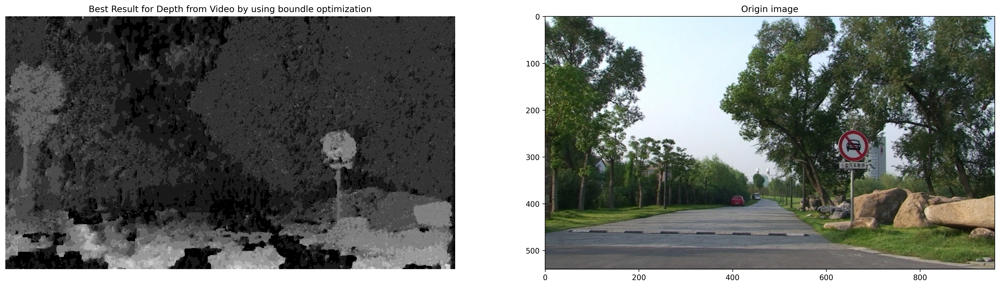

 Finish get depth for frame 100
Disparity Initialization choose_fram ==105 sequence =[106 107 108 109 110 111 112]
Boundle Optimization: choose_fram ==105 sequence =[106 107 108 109 110 111 112]
get_depth_map................................


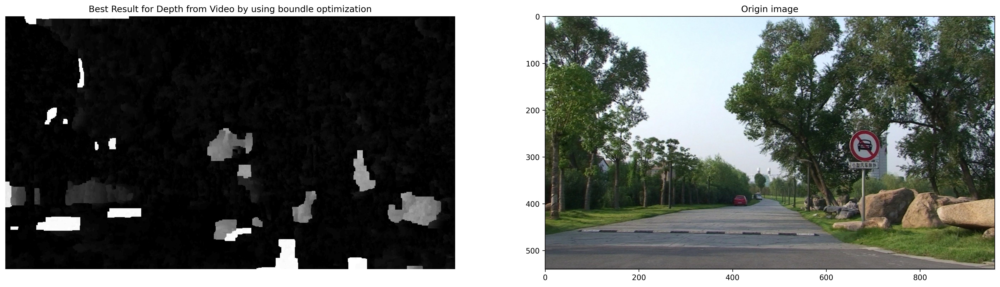

 Finish get depth for frame 105
Disparity Initialization choose_fram ==110 sequence =[111 112 113 114 115 116 117]


KeyboardInterrupt: 

In [19]:
choose_frame_sequence = np.array([100,105,110,115,120,125])
# choose_frame_sequence = np.array([100,105,110])
depthmap_seq = []
for i in range(len(choose_frame_sequence)):
    depthmap_seq.append(get_depth_forframe(choose_frame_sequence[i]))
    print(f' Finish get depth for frame {choose_frame_sequence[i]}')

#### **Sec2** using the RANSAC to get n-1 homography matrix for (n-1) frames with the choose frame -------------> get n-1 homography matrix

In [47]:
depthmap_homo_seq = []
H_seq =[]
for i in range(len(choose_frame_sequence)-1):
    H_seq.append(stitch_image(f'test0{choose_frame_sequence[0]}',f'test0{choose_frame_sequence[i+1]}',depthmap_seq[i+1],pltshow=False))

compute homogrphy matrix for test0100 and test0105
compute homogrphy matrix for test0100 and test0110
compute homogrphy matrix for test0100 and test0115
compute homogrphy matrix for test0100 and test0120
compute homogrphy matrix for test0100 and test0125


#### **Sec 3** make homography transform for the depth map to the chosen frame space ------------->get n depth map after transforming

In [ ]:
cols,rows = depthmap_seq[0].shape
dst_seq = []
xx_seq = []
print(depthmap_seq[0].dtype)
xx = np.where(depthmap_seq[0]>2,1,0)
plt.figure(dpi=300,figsize=(24,8))
plt.subplot(131)
plt.imshow(np.array(depthmap_seq[0]),cmap='gray')
plt.title(f'origin depth map for frame {choose_frame_sequence[0]}')
plt.subplot(132)
plt.imshow(np.array(depthmap_seq[0]),cmap='gray')
plt.title(f'origin depth map for frame {choose_frame_sequence[0]}')
plt.subplot(133)
plt.title(f'show the background for depth map of frame {choose_frame_sequence[0]}')
plt.imshow(xx)
plt.show()
for i in range(len(choose_frame_sequence)-1):
    # Max = np.float32(depthmap_seq[i+1].max())
    # cv.imwrite(f'{i}.png', np.uint8(depthmap_seq[i+1]/Max*255))
    cv.imwrite(f'{i}.png',depthmap_seq[i+1])
    depth = cv.imread(f'{i}.png',cv2.IMREAD_GRAYSCALE)
    dst3 = cv2.warpPerspective(depth,H_seq[i],(rows,cols))
    dst3 = np.array(dst3)
    xx =xx.astype(np.int32)
    xx = np.where(dst3>2,1,0)

    plt.figure(dpi=300,figsize=(24,8))
    plt.subplot(131)
    plt.title(f'origin depth map for frame {choose_frame_sequence[i+1]}')
    plt.imshow(np.array(depth),cmap='gray')
    plt.subplot(132)
    plt.title(f'homography transform for depth map of frame {choose_frame_sequence[i+1]} ')
    plt.imshow(dst3,cmap='gray')
    plt.subplot(133)
    plt.title(f'show the background for depth map of frame {choose_frame_sequence[i+1]}')
    plt.imshow(xx)
    plt.show()
    xx_seq.append(xx)



#### **Sec4** make voting to decide whether the pixel is in the background -------------> get a voting result

In [104]:
xxfinal = np.zeros((cols,rows))
depth_final = np.array(depthmap_seq[0]) # depth0
for i in range (cols):
    for j in range(rows):
        vote = 0
        for d in range(len(xx_seq)):
            vote = vote+xx_seq[d][i,j]
        if vote >=len(xx_seq)/2:
            xxfinal[i,j] = 1
        if xxfinal[i,j] != 1 :
            depth_final[i,j] =0 
            

#### **Sec 5** process the original depth map for the chosen frame by using voting result -------------> get improved result

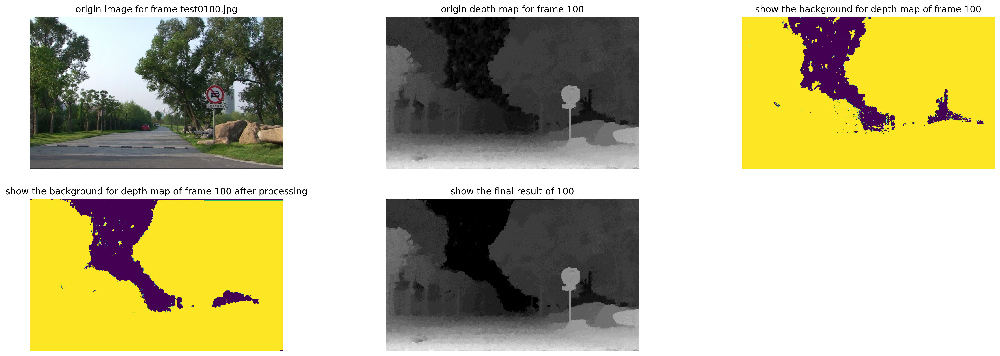

In [105]:
img = cv.imread(files + "/" + f'test0100.jpg')
img = img[:,:,[2,1,0]]
xx = np.where(depthmap_seq[5]>2,1,0)
plt.figure(dpi=300,figsize=(24,8))
plt.subplot(231)
plt.imshow(img[:,0:900])
plt.title(f'origin image for frame test0100.jpg')
plt.axis("off")
plt.subplot(232)
plt.imshow(np.array(depthmap_seq[5][:,0:900]),cmap='gray')
plt.axis("off")
plt.title(f'origin depth map for frame {choose_frame_sequence[0]}')
plt.subplot(233)
plt.title(f'show the background for depth map of frame {choose_frame_sequence[0]}')
plt.imshow(xx[:,0:900])
plt.axis("off")
plt.subplot(234)
plt.title(f'show the background for depth map of frame {choose_frame_sequence[0]} after processing')
plt.imshow(xxfinal[:,0:900]) 
plt.axis("off")
plt.subplot(235)
plt.title(f'show the final result of {choose_frame_sequence[0]}')
plt.imshow(depth_final[:,0:900],cmap='gray') 
plt.axis("off")
plt.show()